In [1]:
import numpy as np
import matplotlib.cbook as cbook
import matplotlib.image as image
import matplotlib.pyplot as plt
import cv2

In [56]:
a_source = cv2.imread('images/a_low_pass_source.png', cv2.IMREAD_GRAYSCALE)

a_fft = np.fft.fft2(a_source)
a_fft_shift = np.fft.fftshift(a_fft)
a_fft_spectrum = np.log(np.abs(a_fft_shift))

In [61]:
a_mask = cv2.circle(np.zeros(a_fft_shift.shape), tuple(i//2 for i in a_fft_shift.shape), 50, 1, thickness=-1)
a_fft_m = np.multiply(a_fft_shift, a_mask)
a_fft_m_spectrum = np.log(np.abs(1+a_fft_m))

a_result = np.fft.fft2(a_fft_m)
a_result_spectrum = np.abs(a_result)

In [62]:
FFT_MAX = np.max(a_fft_spectrum)
FFT_MIN = np.min(a_fft_spectrum)

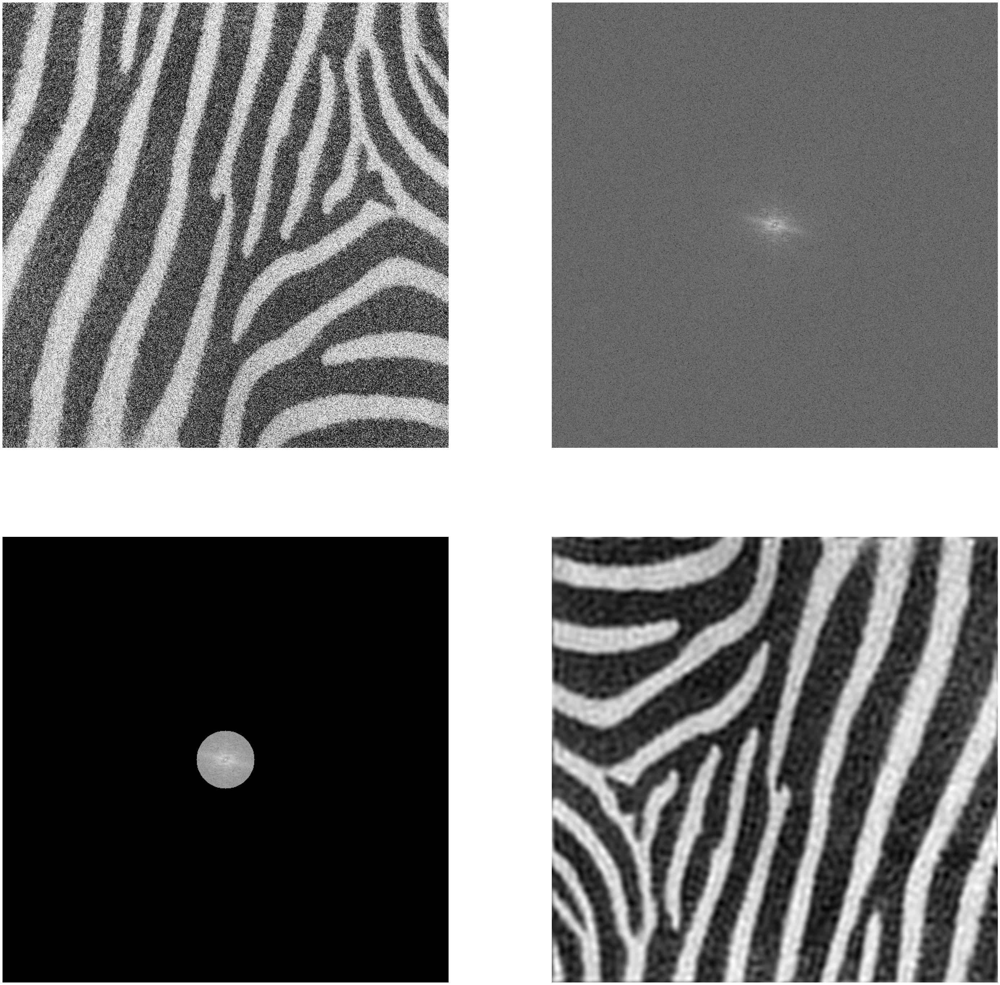

In [63]:
fig = plt.figure(figsize=(50, 50))

fig.add_subplot(2, 2, 1)
plt.axis("off")
plt.imshow(a_source, cmap="gray", vmin=0, vmax=255)

fig.add_subplot(2, 2, 2)
plt.axis("off")
plt.imshow(a_fft_spectrum, cmap="gray", vmin=FFT_MIN, vmax=FFT_MAX)

fig.add_subplot(2, 2, 3)
plt.axis("off")
plt.imshow(a_fft_m_spectrum, cmap="gray")

fig.add_subplot(2, 2, 4)
plt.axis("off")
plt.imshow(a_result_spectrum, cmap="gray")

plt.show()

In [64]:
b_source = cv2.imread('images/b_high_pass_source.png', cv2.IMREAD_GRAYSCALE)

b_fft = np.fft.fft2(b_source)
b_fft_shift = np.fft.fftshift(b_fft)
b_fft_spectrum = np.log(np.abs(b_fft_shift))

In [65]:
b_mask = cv2.circle(np.ones(b_fft_shift.shape), tuple(i//2 for i in b_fft_shift.shape), 50, 0, thickness=-1)
b_fft_m = np.multiply(b_fft_shift, b_mask)
b_fft_m_spectrum = np.log(np.abs(1+b_fft_m))

b_result = np.fft.fft2(b_fft_m)
b_result_spectrum = np.abs(b_result)

In [66]:
FFT_MAX = np.max(b_fft_spectrum)
FFT_MIN = np.min(b_fft_spectrum)

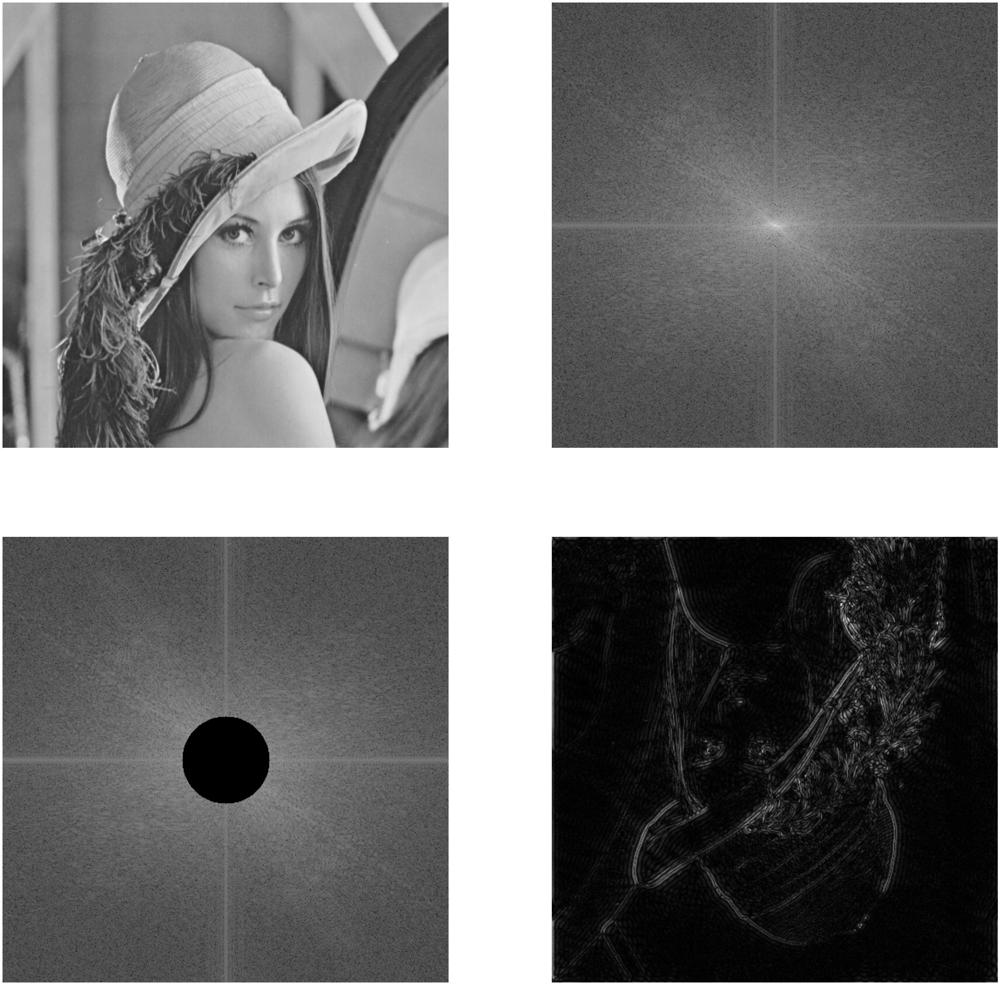

In [67]:
fig = plt.figure(figsize=(50, 50))

fig.add_subplot(2, 2, 1)
plt.axis("off")
plt.imshow(b_source, cmap="gray", vmin=0, vmax=255)

fig.add_subplot(2, 2, 2)
plt.axis("off")
plt.imshow(b_fft_spectrum, cmap="gray", vmin=FFT_MIN, vmax=FFT_MAX)

fig.add_subplot(2, 2, 3)
plt.axis("off")
plt.imshow(b_fft_m_spectrum, cmap="gray", vmin=FFT_MIN, vmax=FFT_MAX)

fig.add_subplot(2, 2, 4)
plt.axis("off")
plt.imshow(b_result_spectrum, cmap="gray")

plt.show()